# MNIST Point Set Visualization
- By running this script, you can get images of point sets.
## To run this code...
- You should prepare the summary file by running sample_and_summarize.py with a trained checkpoint.
- You should install below libraries.
    - matplotlib
    - open3d
    - numpy
    - torch
    - torchvision
    - tqdm

In [192]:
import os
import random
from tqdm.notebook import tqdm
import matplotlib
import matplotlib.pyplot as plt
import open3d as o3d

import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns

%env CUDA_VISIBLE_DEVICES=0
import torch
torch.no_grad()
print("cuda available: " + str(torch.cuda.is_available()))

import cuml
from torchvision.utils import save_image, make_grid

from draw import draw

env: CUDA_VISIBLE_DEVICES=0
cuda available: True


## Set directories
1. summary file path: summary_name
2. path to save images: save_dir

In [193]:
save_dir = 'images'
experiment_name = 'syn_sadefeldman_beta1_noised_std0.73'
summary_name = os.path.join('/localdata/rna_rep_learning/scset/checkpoints/', experiment_name, 'summary.pth')

imgdir = os.path.join(save_dir, experiment_name)
imgdir_gt = os.path.join(imgdir, 'gt')
imgdir_recon = os.path.join(imgdir, 'recon')
imgdir_gen = os.path.join(imgdir, 'gen')

os.makedirs(save_dir, exist_ok=True)
os.makedirs(imgdir_gt, exist_ok=True)
os.makedirs(imgdir_recon, exist_ok=True)
os.makedirs(imgdir_gen, exist_ok=True)

In [194]:
summary = torch.load(summary_name)
for k, v in summary.items():
    try:
        print(f"{k}: {v.shape}")
    except AttributeError:
        print(f"{k}: {len(v)}")

smp_set: torch.Size([120, 700, 20])
smp_mask: torch.Size([120, 700])
smp_att: 5
priors: 6
recon_set: torch.Size([120, 700, 20])
recon_mask: torch.Size([120, 700])
posteriors: 6
dec_att: 5
enc_att: 5
enc_hiddens: 15
gt_set: torch.Size([120, 403, 20])
gt_mask: torch.Size([120, 403])
mean: torch.Size([15])
std: torch.Size([15])
sid: 15
mid: 15
pid: 15
cardinality: 15


## Select the samples to visualize
- parse the samples by index.
- below default code will visualize all samples. **Warning: Requires Huge Memory**

In [195]:
recon_targets = list(range(len(summary['gt_mask'])))[:]
gen_targets = list(range(len(summary['smp_mask'])))[:]

len_att = len(summary['dec_att'])
gt = summary['gt_set'][recon_targets]
gt_mask = summary['gt_mask'][recon_targets]

recon = summary['recon_set'][recon_targets]
recon_mask = summary['recon_mask'][recon_targets]

dec_att = [summary['dec_att'][l][:, :, recon_targets] for l in range(len_att)]
enc_att = [summary['enc_att'][l][:, :, recon_targets] for l in range(len_att)]

gen = summary['smp_set'][gen_targets]
gen_mask = summary['smp_mask'][gen_targets]
gen_att = [summary['smp_att'][l][:, :, gen_targets] for l in range(len_att)]

## Visualize

In [6]:
def visualize(gt, gt_mask):
    return draw(gt, gt_mask)

### Visualize Recon

In [7]:
recon_imgs = visualize(recon, recon_mask)
for idx in range(len(recon_targets)):
    data_idx = recon_targets[idx]
    if torch.nonzero(recon_imgs[idx].float().mean(0) != 1).shape[0] == 0:
        print("SKIP")
        continue
    save_image(recon_imgs[idx] / 255., os.path.join(imgdir_recon, f'{data_idx}.png'))
del recon_imgs

### Visualize GT

In [8]:
gt_imgs = visualize(gt, gt_mask)
for idx in range(len(recon_targets)):
    data_idx = recon_targets[idx]
    if torch.nonzero(gt_imgs[idx].float().mean(0) != 1).shape[0] == 0:
        print("SKIP")
        continue
    save_image(gt_imgs[idx]/255, os.path.join(imgdir_gt, f'{data_idx}.png'))
del gt_imgs

### Visualize Generated Samples

In [9]:
gen_imgs = visualize(gen, gen_mask)
for idx in range(len(gen_targets)):
    if torch.nonzero(gen_imgs[idx].float().mean(0) != 1).shape[0] == 0:
        print("SKIP")
        continue
    data_idx = gen_targets[idx]
    save_image(gen_imgs[idx]/255, os.path.join(imgdir_gen, f'{data_idx}.png'))
del gen_imgs

In [10]:
print("Done")

Done


# Collate data across all samples. run UMAP, and viz

inputs were of size 350 cells each; it reconstructed (and generated) samples of 700 cells each
I thought that reconstruction should be set to have the same cardinality as gt?

In [11]:
print(gt.shape)
print(recon.shape)

torch.Size([120, 403, 20])
torch.Size([120, 700, 20])


In [196]:
gt_adata = sc.read_h5ad("/localdata/rna_rep_learning/sadefeldman/synthetic_data/syn_adata_noised_std_0.7261.h5ad")


In [197]:
recon_adata = sc.AnnData(np.zeros([recon.reshape(-1,20).shape[0], len(gt_adata.var)]))

/tmp/ipykernel_58283/2132546857.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  recon_adata = sc.AnnData(np.zeros([recon.reshape(-1,20).shape[0], len(gt_adata.var)]))


In [198]:
recon_adata.varm['PCs'] = gt_adata.varm['PCs']

In [199]:
recon_adata.obsm['X_pca'] = recon.reshape(-1,20).numpy()

In [200]:
gt_adata.var.columns = [s.replace("_orig_orig_orig_orig_orig","_orig") for s in gt_adata.var.columns]

In [201]:
gt_adata.var

,n_cells_orig,mt_orig,n_cells_by_counts_orig,mean_counts_orig,log1p_mean_counts_orig,pct_dropout_by_counts_orig,total_counts_orig,log1p_total_counts_orig,highly_variable_orig,means_orig,dispersions_orig,dispersions_norm_orig,mean_orig,std_orig,highly_variable,means,dispersions,dispersions_norm,mean,std
TSPAN6,22,False,22,0.007213,0.007187,99.864956,117.510002,4.774997,True,0.168531,5.890073,0.996115,0.005000,0.153394,True,0.194723,6.424015,0.796235,0.004699,0.151153
DPM1,2577,False,2577,1.134288,0.758133,84.181450,18478.693359,9.824428,False,3.789277,6.148362,-0.159175,0.786229,1.898160,False,4.080557,6.981300,-0.104622,0.794398,1.934553
SCYL3,1151,False,1151,0.375726,0.318982,92.934749,6120.957031,8.719637,False,2.281911,5.827548,-0.209597,0.260433,1.058769,False,2.530420,6.657620,-0.101059,0.262716,1.079391
C1orf112,1340,False,1340,0.365990,0.311879,91.774599,5962.341309,8.693386,False,2.066973,5.982718,0.097556,0.253685,0.983348,False,2.310958,6.813054,0.192792,0.254703,1.004864
FGR,2124,False,2124,0.951812,0.668758,86.962126,15505.966797,9.649045,True,3.885009,6.649788,0.596864,0.659745,1.813981,True,4.140545,7.518956,0.822381,0.640782,1.814193
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZBTB8B,89,False,89,0.004250,0.004241,99.453686,69.240005,4.251918,False,0.011163,2.585064,-2.692783,0.002946,0.075132,False,0.019444,3.987187,-1.812168,0.003228,0.085725
RP11-1084J3.4,54,False,54,0.005471,0.005456,99.668529,89.130005,4.501253,False,0.028291,4.853712,-0.160623,0.003792,0.090005,False,0.047739,5.474230,-0.220424,0.004556,0.105021
RP11-944L7.5,16,False,16,0.002617,0.002614,99.901786,42.640003,3.775974,False,0.008720,3.132807,-2.081417,0.001814,0.064452,False,0.012415,3.803857,-2.008407,0.001978,0.069995
RP11-474G23.1,85,False,85,0.014859,0.014749,99.478240,242.059998,5.493309,False,0.065752,3.848240,-1.282884,0.010299,0.162701,False,0.066406,4.410314,-1.359249,0.009295,0.155071


In [202]:
recon_adata.var = gt_adata.var[['n_cells_orig','highly_variable_orig','means_orig','mean_orig','std_orig']]

In [203]:
recon_adata

AnnData object with n_obs × n_vars = 84000 × 18136
    var: 'n_cells_orig', 'highly_variable_orig', 'means_orig', 'mean_orig', 'std_orig'
    obsm: 'X_pca'
    varm: 'PCs'

#### calculate neighbors & UMAP for reconstructed cells

In [20]:
sc.pp.neighbors(recon_adata, n_neighbors=10, n_pcs=20)

In [21]:
sc.tl.umap(recon_adata)

In [204]:
recon_adata.obs['pid'] = np.repeat(np.array(summary['pid']).reshape(-1), recon.shape[1])

In [25]:
#got an error with cmap so manually assigning colors to pids
recon_adata.uns['pid_colors'] = [matplotlib.colors.to_hex(matplotlib.cm.get_cmap('tab20')(i)) for i in np.linspace(0.0, 1.0, len(np.array(summary['pid']).reshape(-1)))]

/opt/conda/rpeyser/envs/scset/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


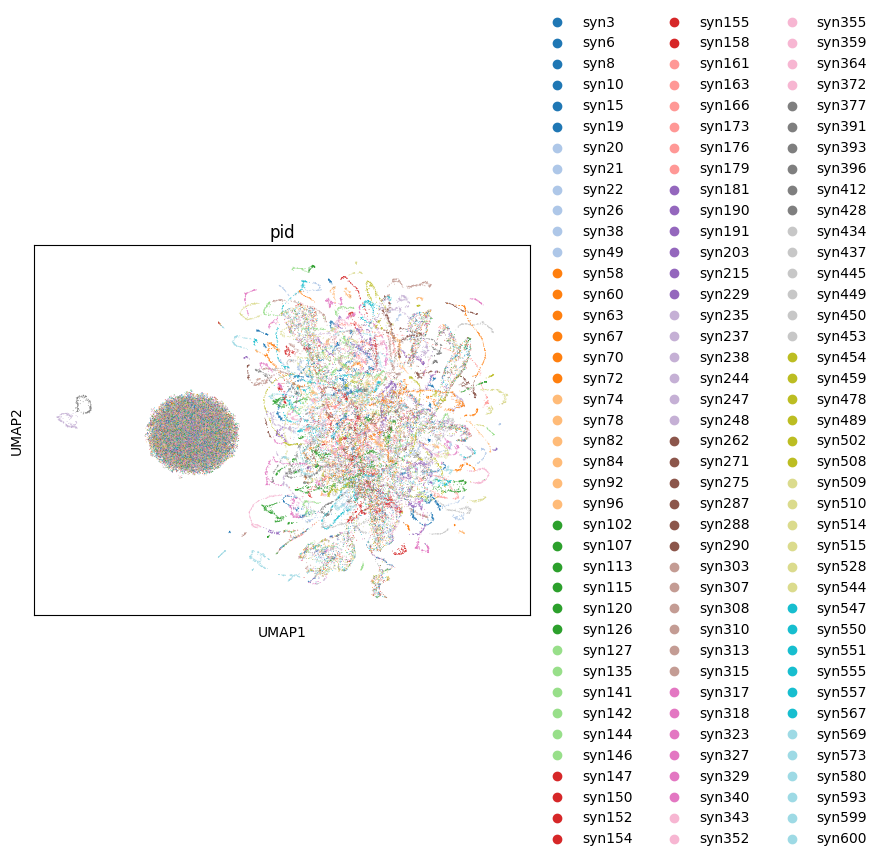

In [26]:
sc.pl.umap(recon_adata, color='pid')

In [27]:
#add PCs to obs in order to color by them
recon_adata.obs = pd.DataFrame(recon_adata.obsm['X_pca'], columns=["PC"+str(i) for i in range(1,recon_adata.obsm['X_pca'].shape[1]+1)])

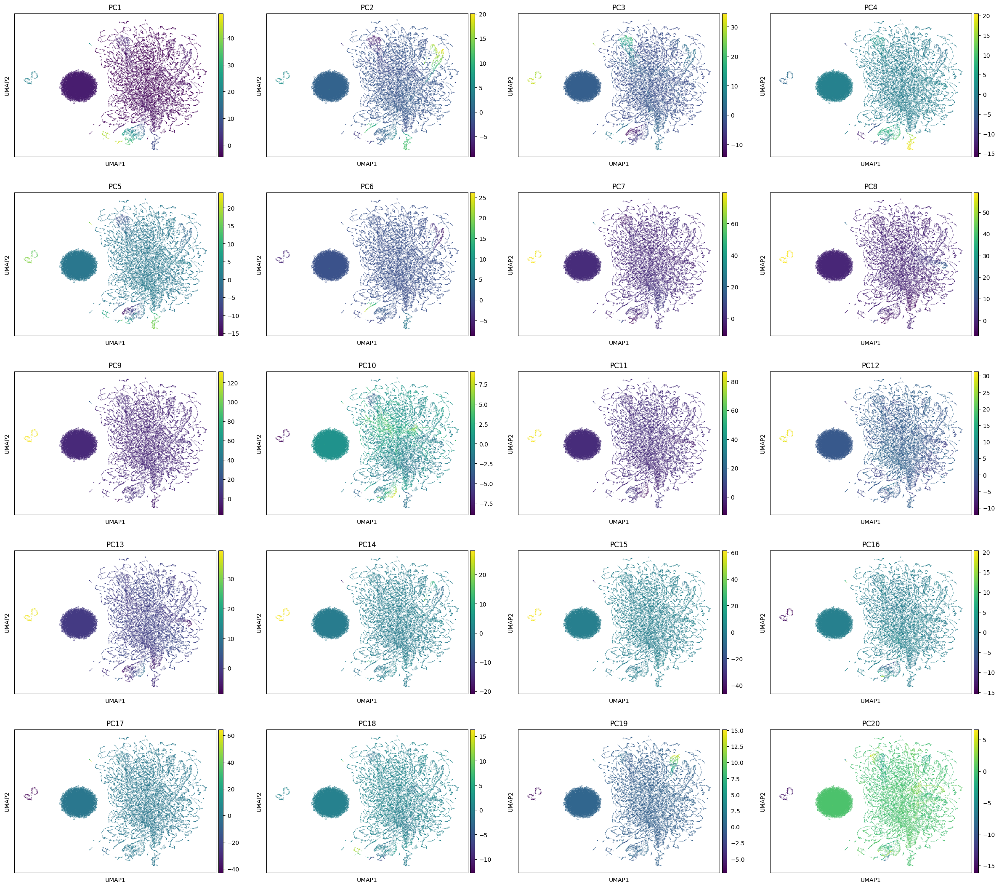

In [28]:
sc.pl.umap(recon_adata, color=["PC"+str(i) for i in range(1,21)])

#### how does UMAP look if trained on subset of the data? answer: bad [tried 10k and 20k; tried default settings and also cuml.UMAP(n_epochs=10000, min_dist = 0, local_connectivity=16)]

In [37]:
n_points = 10000
inds = np.random.choice(recon_adata.shape[0],n_points) #np.arange(n_points)#
umap = cuml.UMAP()#n_epochs=10000, min_dist = 0, local_connectivity=16)
trunc_umap = umap.fit_transform(recon_adata.obsm['X_pca'][inds,:20])

#created truncated adata object
recon_adata_trunc = recon_adata[inds,:].copy()
recon_adata_trunc.obsm['X_umap'] = trunc_umap

/opt/conda/rpeyser/envs/scset/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/opt/conda/rpeyser/envs/scset/lib/python3.8/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


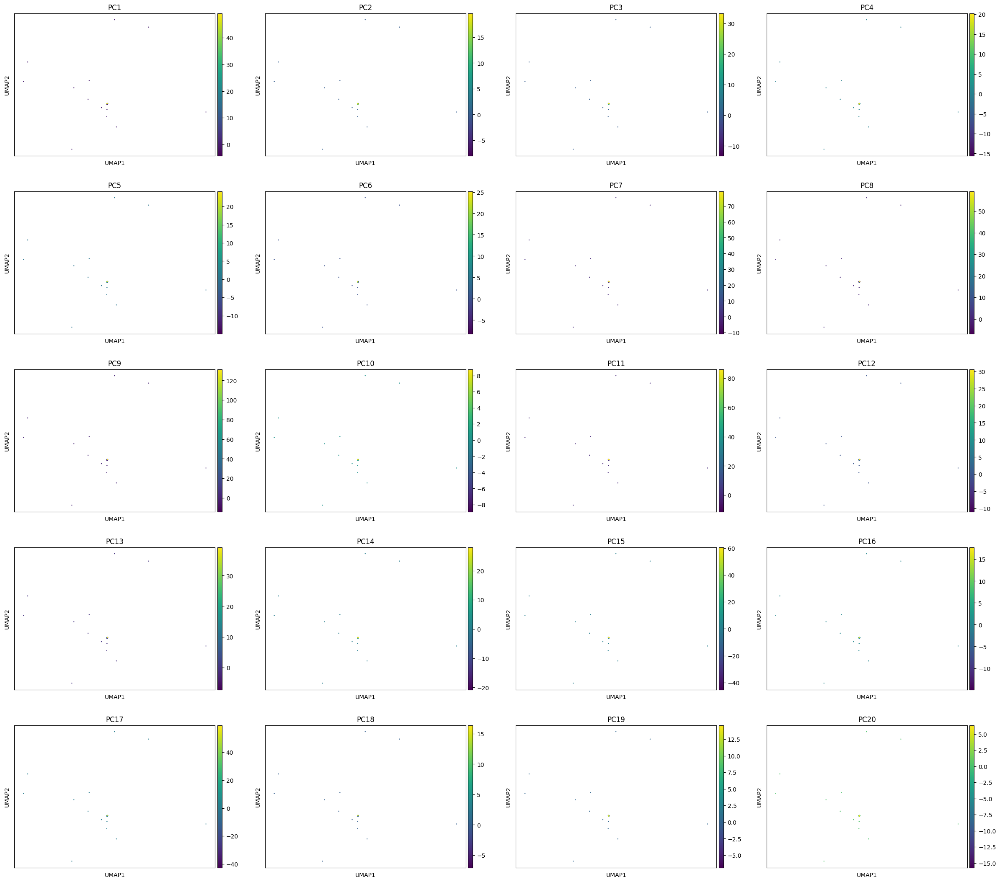

In [38]:
sc.pl.umap(recon_adata_trunc, color=["PC"+str(i) for i in range(1,21)])

#### UMAP on ground truth synthetic data

In [36]:
#run UMAP on the original synthetic gt_adata (in future this might already be saved)
umap = cuml.UMAP(n_epochs=10000, min_dist = 0, local_connectivity=16)
umap_trans = umap.fit_transform(gt_adata.obsm['X_pca'][:,:20])
gt_adata.obsm['X_umap'] = umap_trans

In [110]:
#add PCs to gt obs in order to color by them
gt_adata.obs[["PC"+str(i) for i in range(1,gt_adata.obsm['X_pca'].shape[1]+1)]] = gt_adata.obsm['X_pca']


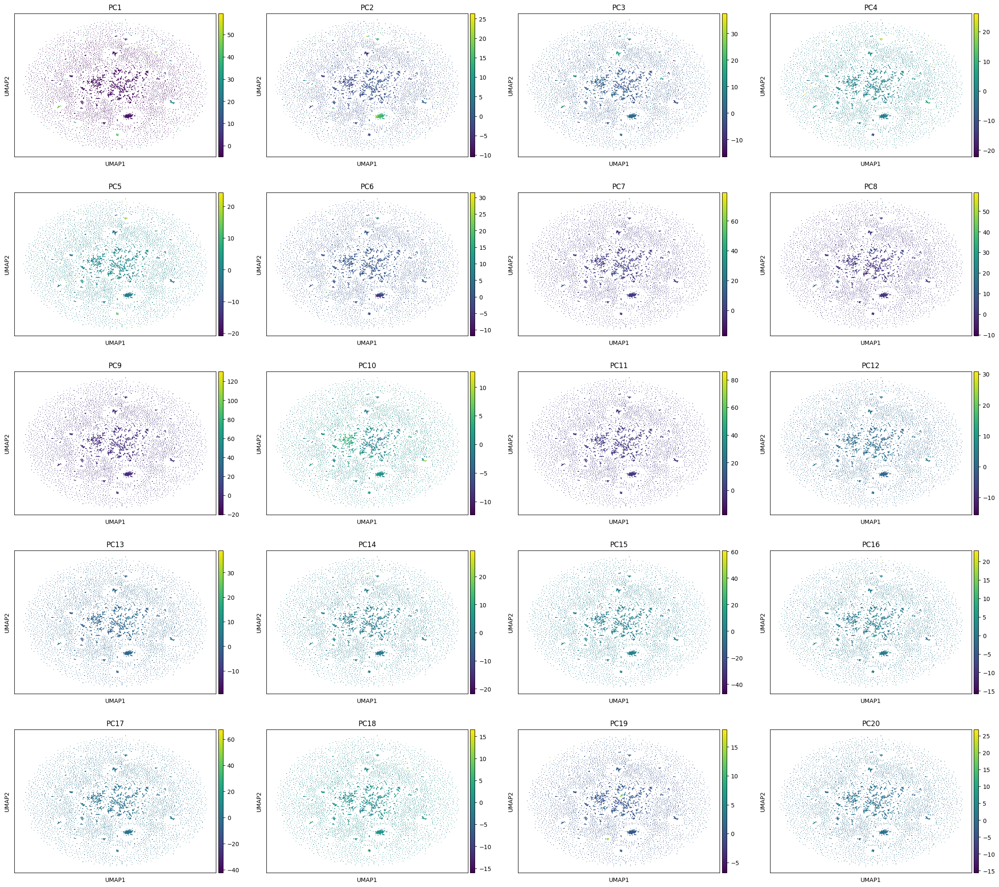

In [39]:
sc.pl.umap(gt_adata, color=["PC"+str(i) for i in range(1,21)])

#### calculate gene expression based on predicted PCs for reconstructed data (as a baseline, check how different PC-reconstructed gene expression and true gene expression is for gt data)

In [40]:
recon_adata.X = np.matmul(recon_adata.obsm['X_pca'], recon_adata.varm['PCs'][:,:20].transpose())

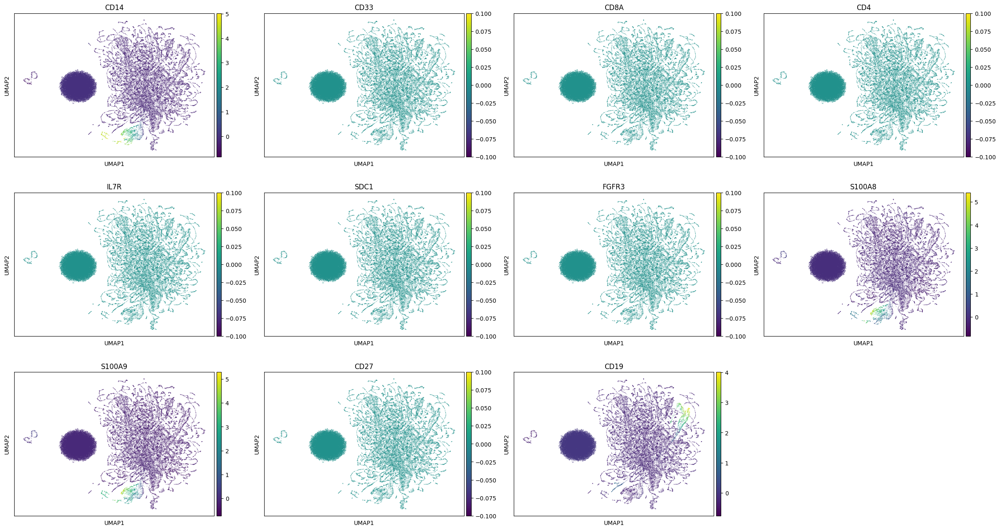

In [44]:
sc.pl.umap(recon_adata, color=['CD14','CD33','CD8A','CD4','IL7R','SDC1','FGFR3','S100A8','S100A9','CD27','CD19'])

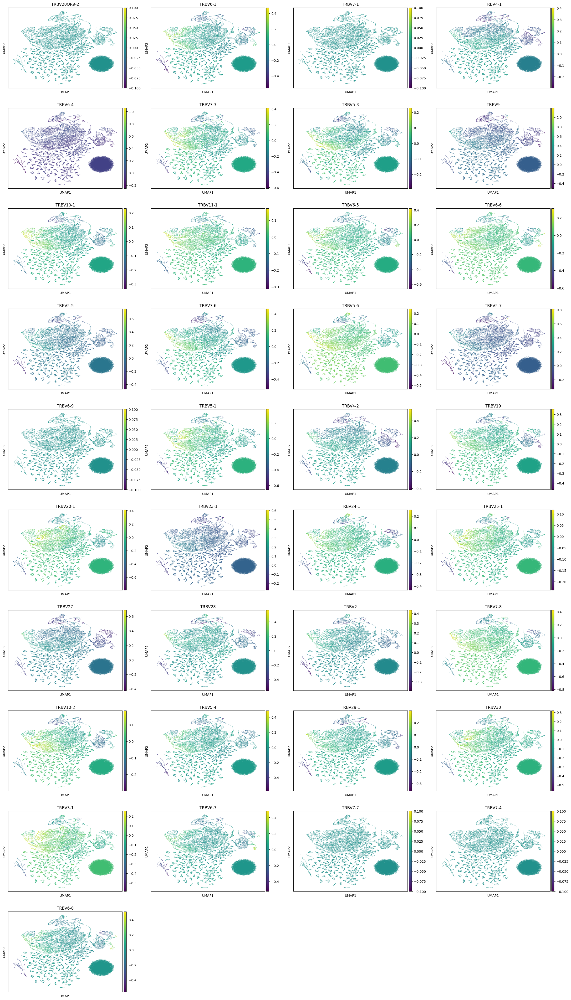

In [10]:
sc.pl.umap(recon_adata, color=recon_adata.var.index[recon_adata.var.index.str.match("TRBV")])

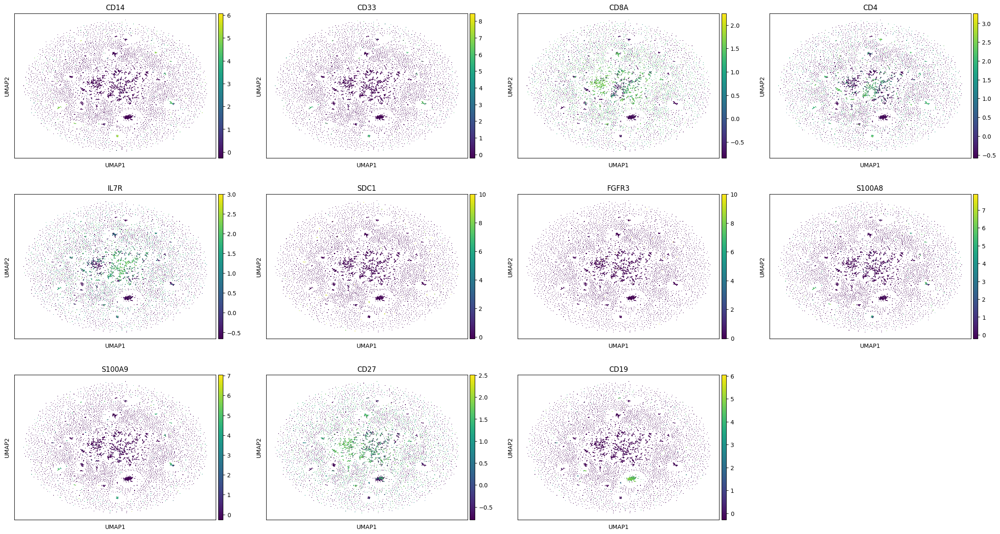

In [45]:
sc.pl.umap(gt_adata, color=['CD14','CD33','CD8A','CD4','IL7R','SDC1','FGFR3','S100A8','S100A9','CD27','CD19'], )

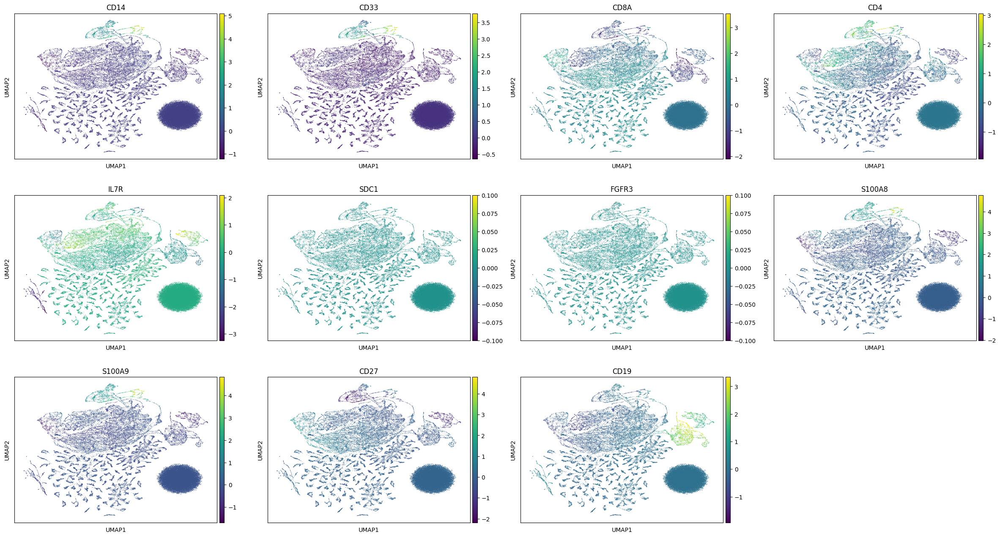

In [ ]:
sc.pl.umap(recon_adata, color=[])

In [46]:
import matplotlib.pyplot as plt

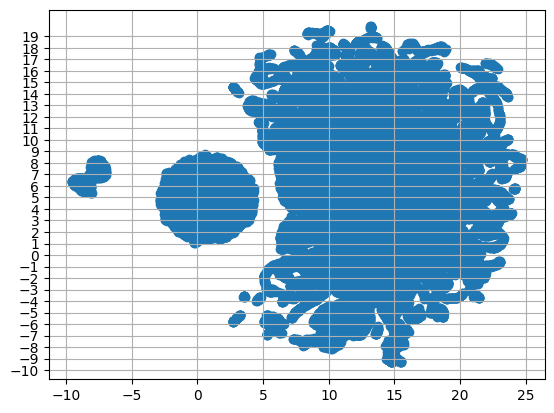

In [59]:
plt.grid(which="both")
plt.yticks(np.arange(-10, 20, 1))
plt.scatter(recon_adata.obsm['X_umap'][:,0], recon_adata.obsm['X_umap'][:,1])

In [72]:
recon_adata[(recon_adata.obsm['X_umap'][:,0]<5) & (recon_adata.obsm['X_umap'][:,0]>-5) & 
            (recon_adata.obsm['X_umap'][:,1]<9) & (recon_adata.obsm['X_umap'][:,1]>0)].obs

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
1,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344
5,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344
10,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344
11,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344
12,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83990,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344
83991,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344
83994,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344
83996,0.022173,0.074953,0.38721,-0.013273,0.144897,0.099855,0.143694,0.061379,0.257784,0.171239,0.000228,-0.148512,-0.298844,-0.277995,-0.070972,0.172486,-0.188816,-0.092102,0.106194,0.213344


In [79]:
# for each pc, how many cells dont have median value?
for pc in ["PC"+str(i) for i in range(1,21)]:
    print(str((recon_adata[(recon_adata.obsm['X_umap'][:,0]<5) & (recon_adata.obsm['X_umap'][:,0]>-5) & 
            (recon_adata.obsm['X_umap'][:,1]<9) & (recon_adata.obsm['X_umap'][:,1]>0)].obs[pc]!=
recon_adata[(recon_adata.obsm['X_umap'][:,0]<5) & (recon_adata.obsm['X_umap'][:,0]>-5) & 
            (recon_adata.obsm['X_umap'][:,1]<9) & (recon_adata.obsm['X_umap'][:,1]>0)].obs[pc].median()).sum()) + " cells don't match median value for " + pc)
    

11 cells don't match median value for PC1
11 cells don't match median value for PC2
11 cells don't match median value for PC3
11 cells don't match median value for PC4
11 cells don't match median value for PC5
11 cells don't match median value for PC6
11 cells don't match median value for PC7
11 cells don't match median value for PC8
11 cells don't match median value for PC9
11 cells don't match median value for PC10
11 cells don't match median value for PC11
11 cells don't match median value for PC12
11 cells don't match median value for PC13
11 cells don't match median value for PC14
11 cells don't match median value for PC15
11 cells don't match median value for PC16
11 cells don't match median value for PC17
11 cells don't match median value for PC18
11 cells don't match median value for PC19
11 cells don't match median value for PC20


# do reconstructed training images have same issue 

In [124]:
experiment_name = 'syn_sadefeldman_beta1_noised_std0.73'
summary_train_name = os.path.join('/localdata/rna_rep_learning/scset/checkpoints/', experiment_name, 'summary_train_recon.pth')

summary_train = torch.load(summary_train_name)
for k, v in summary_train.items():
    try:
        print(f"{k}: {v.shape}")
    except AttributeError:
        print(f"{k}: {len(v)}")

recon_set: torch.Size([480, 700, 20])
recon_mask: torch.Size([480, 700])
posteriors: 6
dec_att: 5
enc_att: 5
enc_hiddens: 60
gt_set: torch.Size([480, 403, 20])
gt_mask: torch.Size([480, 403])
mean: torch.Size([60])
std: torch.Size([60])
sid: 60
mid: 60
pid: 60
cardinality: 60


In [169]:
len_att = len(summary_train['dec_att'])
gt_train = summary_train['gt_set']
gt_mask_train = summary_train['gt_mask']

recon_train = summary_train['recon_set']
recon_mask_train = summary_train['recon_mask']

dec_att_train = [summary_train['dec_att'][l] for l in range(len_att)]
enc_att_train = [summary_train['enc_att'][l] for l in range(len_att)]

In [170]:
recon_train_adata = sc.AnnData(np.zeros([recon_train.reshape(-1,20).shape[0], len(gt_adata.var)]))

/tmp/ipykernel_105399/392706389.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  recon_train_adata = sc.AnnData(np.zeros([recon_train.reshape(-1,20).shape[0], len(gt_adata.var)]))


In [171]:
recon_train_adata.varm['PCs'] = gt_adata.varm['PCs']

In [172]:
recon_train_adata.obsm['X_pca'] = recon_train.reshape(-1,20).numpy()

In [173]:
recon_train_adata.var = gt_adata.var[['n_cells_orig','highly_variable_orig','means_orig','mean_orig','std_orig']]

In [174]:
recon_train_adata

AnnData object with n_obs × n_vars = 336000 × 18136
    var: 'n_cells_orig', 'highly_variable_orig', 'means_orig', 'mean_orig', 'std_orig'
    obsm: 'X_pca'
    varm: 'PCs'

#### calculate neighbors & UMAP for reconstructed cells

In [199]:
#neighbors; sc.tl.umap(recon_adata) #going to take too long, use cuml
umap = cuml.UMAP(min_dist = 0.1, n_epochs=10000)#, local_connectivity=16) #n_epochs=1000, 
umap_trans = umap.fit_transform(recon_train_adata.obsm['X_pca'][:,:20])
recon_train_adata.obsm['X_umap'] = umap_trans

(array([1.0000e+00, 0.0000e+00, 0.0000e+00, 6.7199e+05, 8.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([-225169.125  , -165791.65625, -106414.1875 ,  -47036.71875,
          12340.75   ,   71718.21875,  131095.6875 ,  190473.15625,
         249850.625  ,  309228.09375,  368605.5625 ]),
 <BarContainer object of 10 artists>)

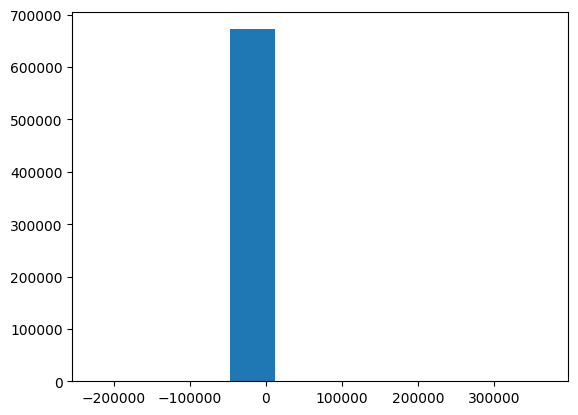

In [200]:
plt.hist(recon_train_adata.obsm['X_umap'].reshape(-1))

Text(0, 0.5, 'principal component 2')

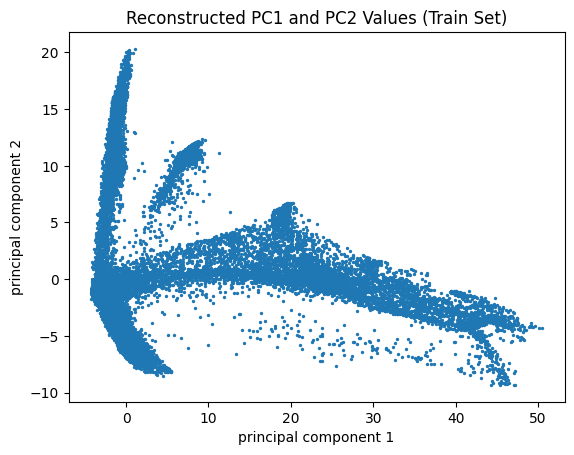

In [203]:
plt.scatter(recon_train_adata.obsm['X_pca'] [:,0], recon_train_adata.obsm['X_pca'][:,1], s=2)
plt.title("Reconstructed PC1 and PC2 Values (Train Set)")
plt.xlabel("principal component 1")
plt.ylabel("principal component 2")

Text(0, 0.5, 'principal component 2')

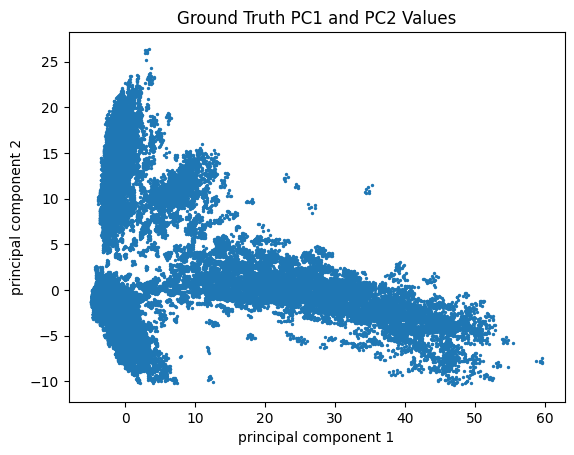

In [202]:
plt.scatter(gt_adata.obsm['X_pca'] [:,0], gt_adata.obsm['X_pca'][:,1], s=2)
plt.title("Ground Truth PC1 and PC2 Values")
plt.xlabel("principal component 1")
plt.ylabel("principal component 2")


In [185]:
recon_train_adata.obs['pid'] = np.repeat(np.array(summary_train['pid']).reshape(-1), recon_train.shape[1])

In [186]:
#got an error with cmap so manually assigning colors to pids
recon_train_adata.uns['pid_colors'] = [matplotlib.colors.to_hex(matplotlib.cm.get_cmap('tab20')(i)) for i in np.linspace(0.0, 1.0, len(np.array(summary_train['pid']).reshape(-1)))]

/opt/conda/rpeyser/envs/scset/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


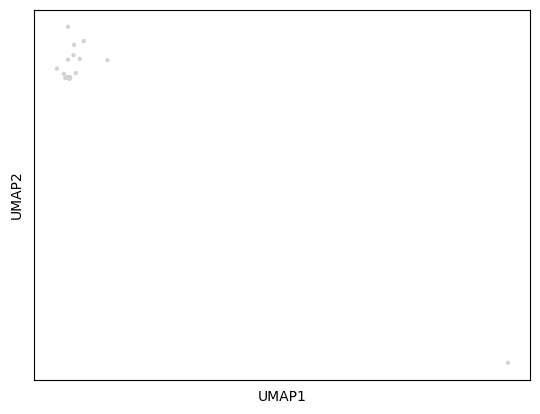

In [209]:
sc.pl.umap(recon_train_adata, s=40)#, color="pid")

# What were in the inputs at the top of the decoder that led to these identical outputs?

In [40]:
save_dir = 'images'
experiment_name = 'syn_sadefeldman_beta1_noised_std0.73'
summary_name = os.path.join('/localdata/rna_rep_learning/scset/checkpoints/', experiment_name, 'summary.pth')

imgdir = os.path.join(save_dir, experiment_name)
imgdir_gt = os.path.join(imgdir, 'gt')
imgdir_recon = os.path.join(imgdir, 'recon')
imgdir_gen = os.path.join(imgdir, 'gen')

os.makedirs(save_dir, exist_ok=True)
os.makedirs(imgdir_gt, exist_ok=True)
os.makedirs(imgdir_recon, exist_ok=True)
os.makedirs(imgdir_gen, exist_ok=True)

In [41]:
summary = torch.load(summary_name)
for k, v in summary.items():
    try:
        print(f"{k}: {v.shape}")
    except AttributeError:
        print(f"{k}: {len(v)}")
        
#there are 15 batches
#each batch is size 8

# summary['enc_hiddens'] is list of size 15 (n batches). Each list contains a tensor of size 5 (number of VAE layers). Each tensor is [8, M, 64] = [batch, init_dim (M inducing points, ranging from 32 to 2), hidden_dim]

smp_set: torch.Size([120, 700, 20])
smp_mask: torch.Size([120, 700])
smp_att: 5
priors: 6
recon_set: torch.Size([120, 700, 20])
recon_mask: torch.Size([120, 700])
posteriors: 6
dec_att: 5
enc_att: 5
enc_hiddens: 15
gt_set: torch.Size([120, 403, 20])
gt_mask: torch.Size([120, 403])
mean: torch.Size([15])
std: torch.Size([15])
sid: 15
mid: 15
pid: 15
cardinality: 15


In [52]:
len(summary['pid'][0])

8

In [47]:
len(summary['enc_hiddens'])

15

In [53]:
len(summary['enc_hiddens'][1])

5

In [46]:
summary['enc_hiddens']

torch.Size([8, 32, 64])

# Viz Patient Reps

### val set

In [77]:
val_hiddens = torch.concat([batch[-1] for batch in summary['enc_hiddens']]) #final hidden rep in encoder for each patient in the val set

In [86]:
val_hiddens = val_hiddens.reshape(val_hiddens.shape[0], -1)

In [111]:
val_hiddens.std(axis=0)

128

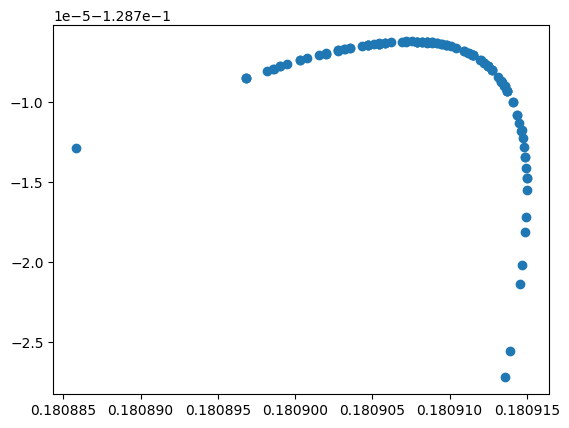

In [147]:
plt.scatter(val_hiddens[:,0],val_hiddens[:,1])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

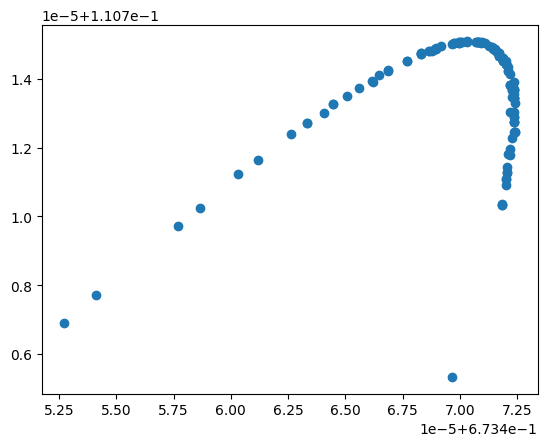

In [148]:
plt.scatter(val_hiddens[:,2],val_hiddens[:,3])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

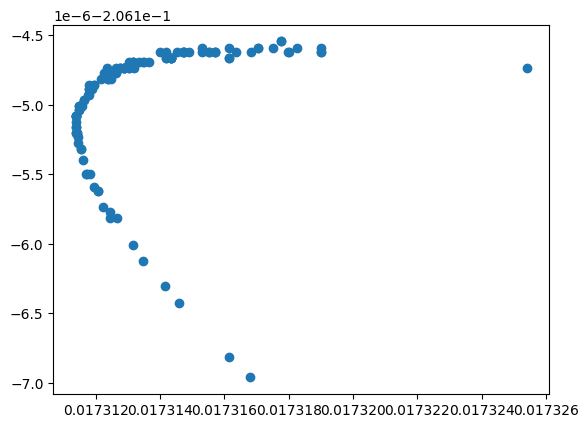

In [149]:
plt.scatter(val_hiddens[:,4],val_hiddens[:,5])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

In [152]:
val_hiddens.shape

torch.Size([120, 128])

Text(0.5, 23.52222222222222, 'hidden dimension at final encoder layer (128 dimensions)')

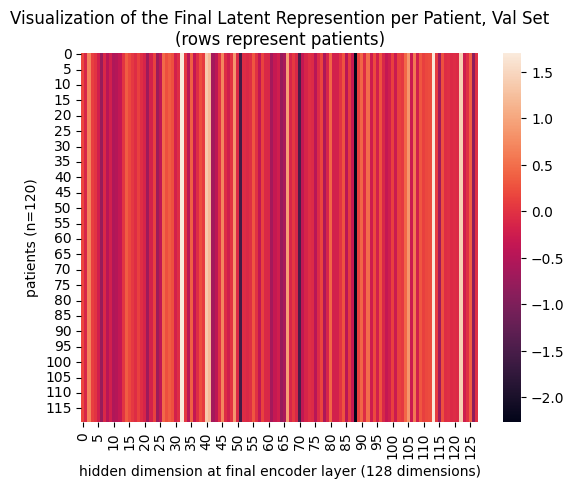

In [161]:
# visualize the dataset in heatmap
sns.heatmap(val_hiddens)
plt.title("Visualization of the Final Latent Represention per Patient, Val Set\n(rows represent patients)")
plt.ylabel("patients (n={})".format(len(val_hiddens)))
plt.xlabel("hidden dimension at final encoder layer (128 dimensions)")

Text(0.5, 23.52222222222222, 'hidden dimension at final encoder layer (128 dimensions)')

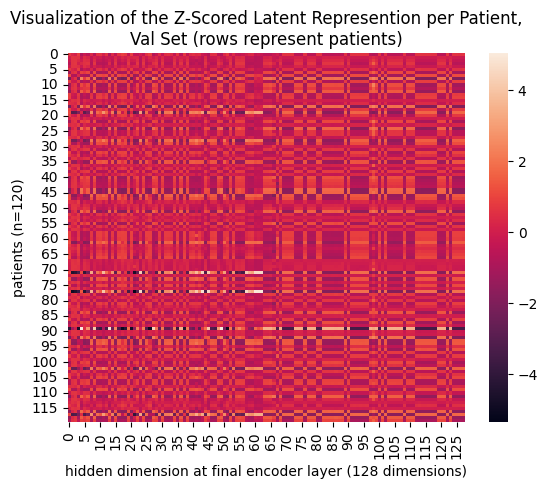

In [243]:
# z score each latent dimension across patients
scaled_hiddens = (val_hiddens - val_hiddens.mean(axis=0)) / val_hiddens.std(axis=0)
sns.heatmap(scaled_hiddens)
plt.title("Visualization of the Z-Scored Latent Represention per Patient,\nVal Set (rows represent patients)")
plt.ylabel("patients (n={})".format(len(scaled_hiddens)))
plt.xlabel("hidden dimension at final encoder layer (128 dimensions)")

### repeat for all levels of encoder

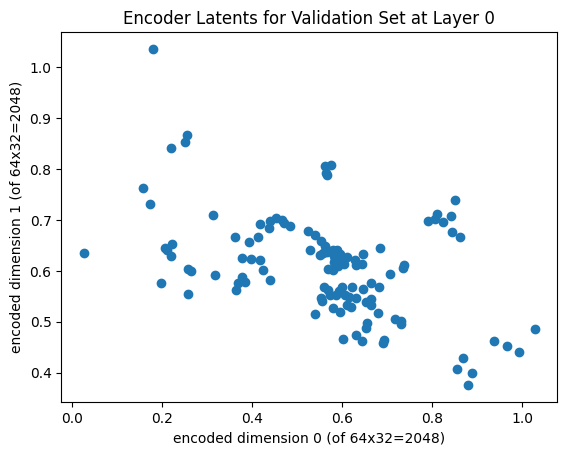

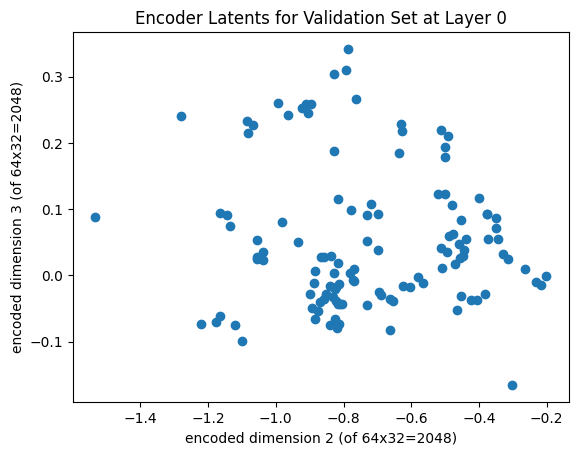

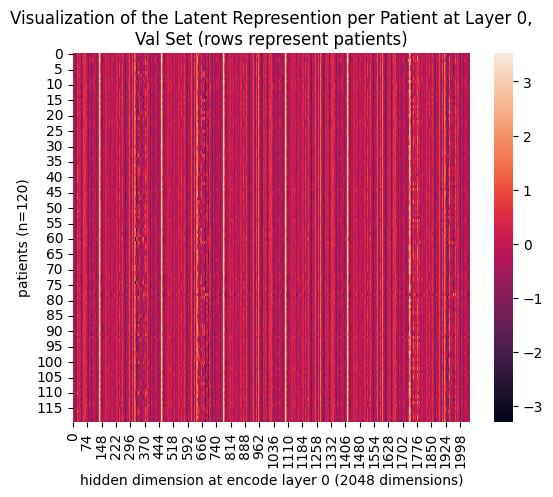

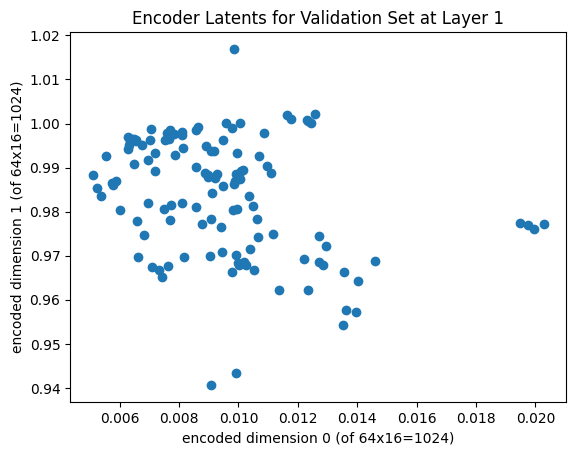

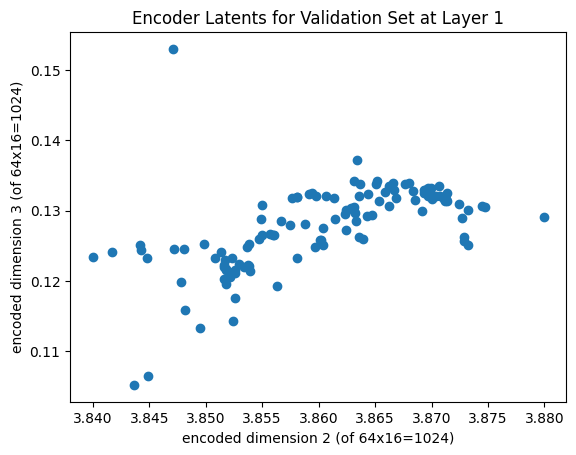

...

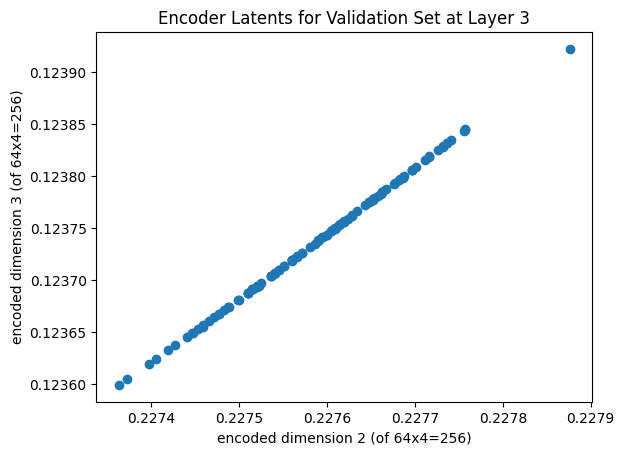

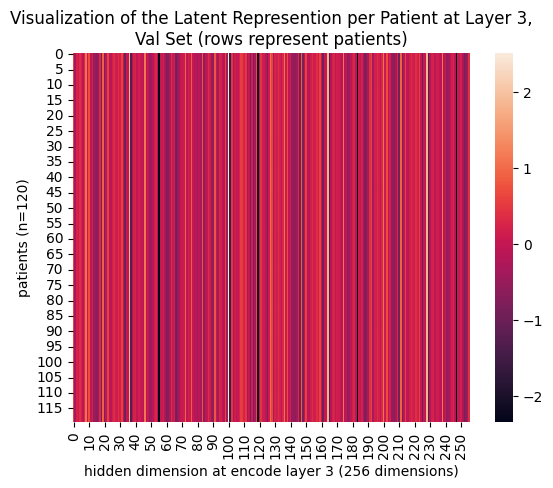

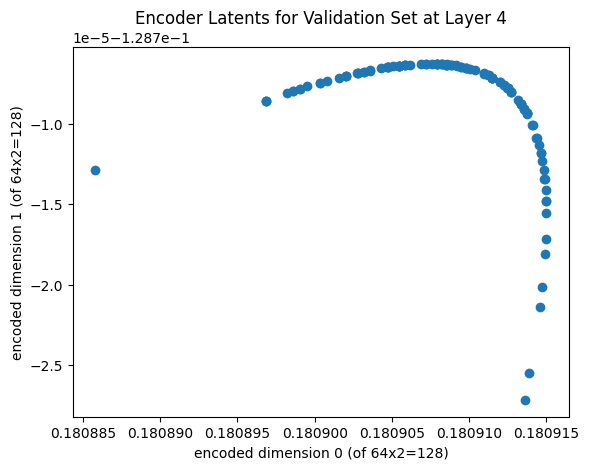

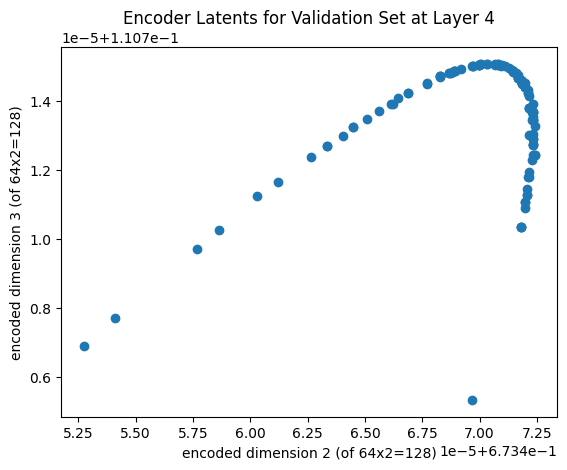

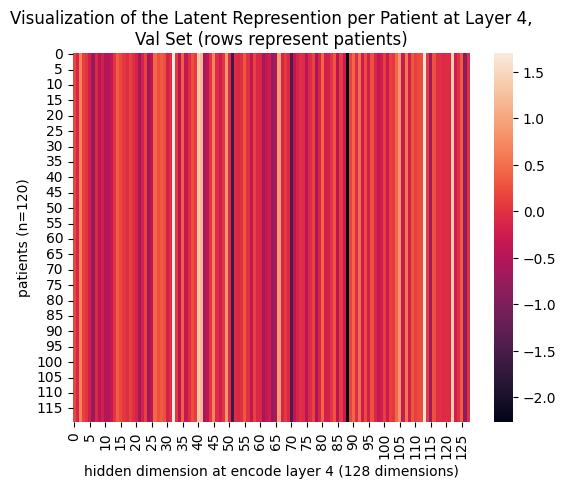

In [188]:
for layer in np.arange(len(summary['enc_hiddens'][0])):
    val_hiddens = torch.concat([batch[layer] for batch in summary['enc_hiddens']]) #final hidden rep in encoder for each patient in the val set
    val_hiddens = val_hiddens.reshape(val_hiddens.shape[0], -1)

    plt.scatter(val_hiddens[:,0],val_hiddens[:,1])
    plt.title("Encoder Latents for Validation Set at Layer {}".format(layer))
    plt.xlabel("encoded dimension 0 (of 64x{}={})".format(summary['enc_hiddens'][0][layer].shape[1], summary['enc_hiddens'][0][layer].shape[1]*64))
    plt.ylabel("encoded dimension 1 (of 64x{}={})".format(summary['enc_hiddens'][0][layer].shape[1], summary['enc_hiddens'][0][layer].shape[1]*64))
    plt.show()
    
    plt.scatter(val_hiddens[:,2],val_hiddens[:,3])
    plt.title("Encoder Latents for Validation Set at Layer {}".format(layer))
    plt.xlabel("encoded dimension 2 (of 64x{}={})".format(summary['enc_hiddens'][0][layer].shape[1], summary['enc_hiddens'][0][layer].shape[1]*64))
    plt.ylabel("encoded dimension 3 (of 64x{}={})".format(summary['enc_hiddens'][0][layer].shape[1], summary['enc_hiddens'][0][layer].shape[1]*64))
    plt.show()
    
    # visualize the dataset in heatmap
    sns.heatmap(val_hiddens)
    plt.title("Visualization of the Latent Represention per Patient at Layer {},\nVal Set (rows represent patients)".format(layer))
    plt.ylabel("patients (n={})".format(len(val_hiddens)))
    plt.xlabel("hidden dimension at encode layer {} ({} dimensions)".format(layer, val_hiddens.shape[1]))
    plt.show()

### train set

In [219]:
train_hiddens = torch.concat([batch[-1] for batch in summary_train['enc_hiddens']]) #final hidden rep in encoder for each patient in the val set
train_hiddens = train_hiddens.reshape(train_hiddens.shape[0], -1)

In [140]:
train_hiddens.std(axis=0)

tensor([3.7827e-05, 1.0822e-04, 8.9521e-05, 5.7387e-05, 4.9833e-05, 9.6194e-06,
        6.6431e-05, 1.0647e-04, 2.9288e-06, 5.8127e-06, 1.9315e-05, 5.0051e-05,
        3.7325e-06, 5.1823e-05, 2.0541e-05, 1.0815e-04, 2.5843e-06, 1.5506e-05,
        1.1039e-05, 8.4625e-06, 1.5827e-05, 4.7702e-06, 1.0198e-04, 1.9456e-04,
        1.8481e-04, 1.3990e-05, 7.5344e-05, 3.5520e-05, 8.3969e-05, 2.3185e-05,
        4.3492e-05, 3.6525e-05, 1.4824e-05, 4.6443e-05, 7.4154e-05, 1.0969e-05,
        5.4865e-06, 5.7066e-05, 7.3156e-05, 3.9457e-05, 2.5092e-05, 5.8375e-06,
        6.0133e-05, 5.9937e-05, 2.6651e-05, 4.2648e-05, 1.5655e-05, 2.3654e-06,
        5.7302e-05, 1.1058e-04, 5.0689e-05, 2.2465e-05, 4.5491e-05, 1.6715e-05,
        2.2706e-05, 5.7386e-05, 4.5279e-05, 5.4124e-05, 7.4421e-05, 9.7237e-05,
        9.7574e-06, 8.0486e-05, 1.4698e-04, 3.4192e-06, 8.9547e-06, 9.5996e-07,
        2.1824e-07, 8.0199e-08, 3.9961e-07, 7.1479e-06, 9.6304e-06, 1.5387e-05,
        1.2490e-06, 3.4669e-06, 1.0409e-

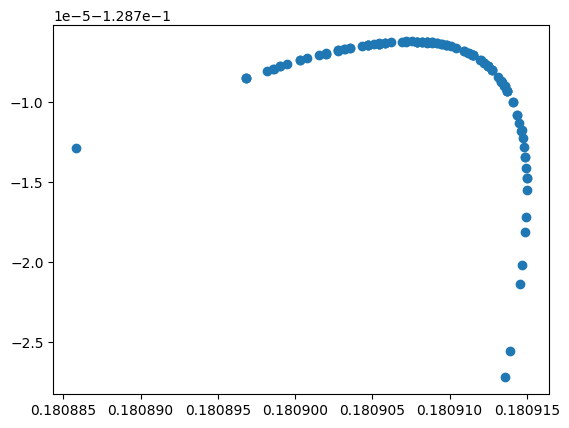

In [220]:
plt.scatter(val_hiddens[:,0],val_hiddens[:,1])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

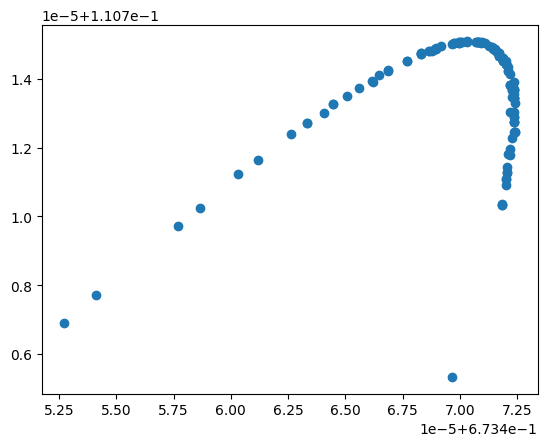

In [145]:
plt.scatter(val_hiddens[:,2],val_hiddens[:,3])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

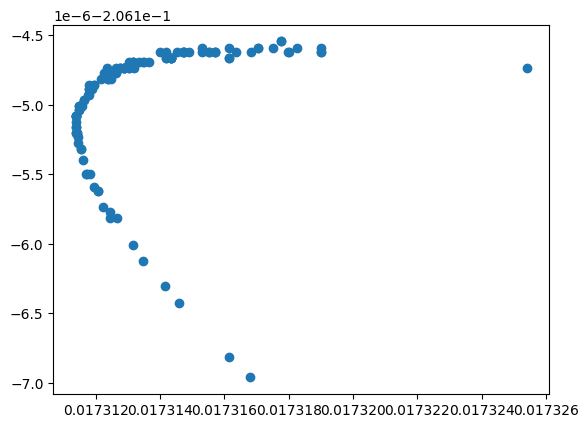

In [146]:
plt.scatter(val_hiddens[:,4],val_hiddens[:,5])
#plt.xlim(-1,1)
#plt.ylim(-1,1)

In [236]:
train_hiddens[1,0] - train_hiddens.mean(axis=0)[0]

tensor(3.7551e-06)

In [239]:
train_hiddens[1,0]- train_hiddens.mean(axis=0)[0]

tensor(3.7551e-06)

In [240]:
train_hiddens[0,0]- train_hiddens.mean(axis=0)[0]

tensor(8.4937e-06)

In [233]:
train_hiddens.mean(axis=0).shape

torch.Size([128])

tensor([[ 8.4937e-06,  2.5779e-06,  9.5367e-07,  ...,  1.0759e-05,
          1.0014e-05,  3.6694e-07],
        [ 3.7551e-06,  7.3612e-06,  5.8413e-06,  ...,  1.5795e-06,
          1.4901e-06,  3.9116e-08],
        [ 6.4373e-06,  6.0797e-06,  4.2915e-06,  ...,  6.0499e-06,
          5.5432e-06,  2.1420e-07],
        ...,
        [-6.5565e-06,  6.1840e-06,  6.4969e-06,  ..., -1.2398e-05,
         -1.1563e-05, -4.1910e-07],
        [ 1.3411e-07,  7.5549e-06,  6.6757e-06,  ..., -3.5763e-06,
         -3.3975e-06, -1.0245e-07],
        [ 1.8626e-06,  7.5996e-06,  6.2585e-06,  ..., -1.2219e-06,
         -9.5367e-07, -4.8429e-08]])

Text(0.5, 23.52222222222222, 'hidden dimension at final encoder layer (128 dimensions)')

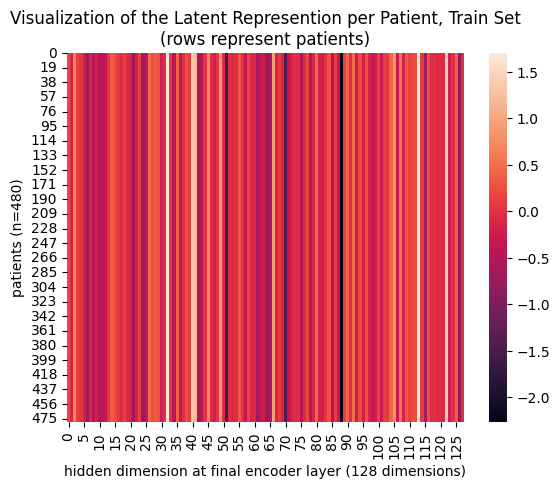

In [159]:
# visualize the dataset in heatmap
sns.heatmap(train_hiddens)
plt.title("Visualization of the Latent Represention per Patient, Train Set\n(rows represent patients)")
plt.ylabel("patients (n={})".format(len(train_hiddens)))
plt.xlabel("hidden dimension at final encoder layer (128 dimensions)")

<AxesSubplot: >

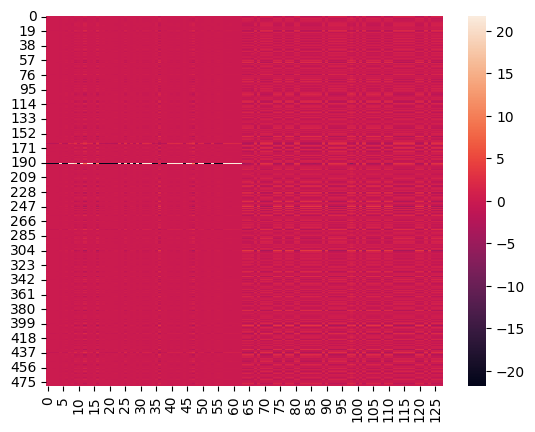

In [241]:
scaled_hiddens = (train_hiddens - train_hiddens.mean(axis=0)) / train_hiddens.std(axis=0)
sns.heatmap(scaled_hiddens)
plt.title("Visualization of the Latent Represention per Patient, Train Set\n(rows represent patients)")
plt.ylabel("patients (n={})".format(len(train_hiddens)))
plt.xlabel("hidden dimension at final encoder layer (128 dimensions)")

# PCA for 10 patients

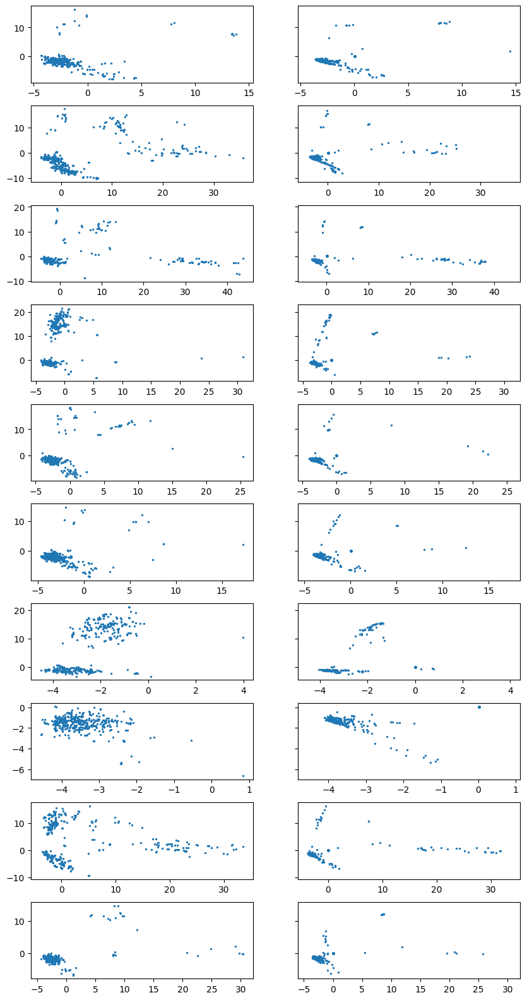

In [218]:
fig, axs = plt.subplots(10, 2, figsize=(10,20), sharex="row", sharey="row", gridspec_kw={'hspace':0.3})
for idx, pid in enumerate(recon_adata.obs.pid.drop_duplicates()[:10]):
    axs[idx, 0].scatter(gt_adata[gt_adata.obs.syn_pid == pid].obsm['X_pca'][:,0], gt_adata[gt_adata.obs.syn_pid == pid].obsm['X_pca'][:,1], s=2)
    axs[idx, 1].scatter(recon_adata[recon_adata.obs.pid==pid].obsm['X_pca'][:,0], recon_adata[recon_adata.obs.pid==pid].obsm['X_pca'][:,1], s=2)
plt.show()

In [ ]:
plt.scatter(recon_train_adata.obsm['X_pca'] [:,0], recon_train_adata.obsm['X_pca'][:,1], s=2)
plt.title("Reconstructed PC1 and PC2 Values (Train Set)")
plt.xlabel("principal component 1")
plt.ylabel("principal component 2")